In [27]:
import pandas as pd
import numpy as np
import datetime as dt
import yfinance as yf
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import cufflinks as cf

In [11]:
stock_df = pd.read_csv('Amazon.csv')
JPM_df = pd.read_csv("JPM.csv")

In [16]:
stock_df['Daily Return'] = stock_df['Adj Close'].pct_change(1) * 100
stock_df['Daily Return'].replace(np.nan, 0, inplace = True)

In [17]:
stock_df.describe().round(2)

,Open,High,Low,Close,Adj Close,Volume,Daily Return
count,1259.00,1259.00,1259.00,1259.00,1259.00,1.259000e+03,1259.00
mean,136.15,137.81,134.41,136.13,136.13,7.090839e+07,0.08
std,31.39,31.59,31.12,31.34,31.34,3.298380e+07,2.21
min,82.08,83.48,81.30,81.82,81.82,1.762600e+07,-14.05
25%,104.03,106.03,102.48,104.20,104.20,4.960935e+07,-1.09
50%,140.55,143.12,138.36,139.98,139.98,6.234800e+07,0.07
75%,163.67,165.22,161.63,163.42,163.42,8.347075e+07,1.21
max,195.01,199.83,194.20,197.85,197.85,3.113460e+08,13.54


In [18]:
JPM_df["Daily Return"] = JPM_df['Adj Close'].pct_change(1)*100
JPM_df["Daily Return"].max()

18.012478237116603

In [19]:
fig = px.line(title = 'Amazon.com, Inc. (AMZN) Adjusted Closing Price [$]')
fig.add_scatter(x = stock_df['Date'], y = stock_df['Adj Close'], name = 'Adj Close')

In [20]:
def plot_financial_data(df, title):
    
    fig = px.line(title = title)
    
    for i in df.columns[1:]:
        fig.add_scatter(x = df['Date'], y = df[i], name = i)
        fig.update_traces(line_width = 5)
        fig.update_layout({'plot_bgcolor': "white"})

    fig.show()

In [21]:
plot_financial_data(stock_df.drop(['Volume', 'Daily Return'], axis = 1), 'Amazon.com, Inc. (AMZN) Stock Price [$]')

In [22]:
plot_financial_data(stock_df.iloc[:,[0,5]], 'Amazon.com, Inc. (AMZN) Trading Volume')

In [23]:
plot_financial_data(stock_df.iloc[:,[0,7]], 'Amazon.com, Inc. (AMZN) Percentage Daily Return [%]')

In [24]:
plot_financial_data(JPM_df.drop(["Volume", "Daily Return"], axis = 1), "JPMC Stock Price Movement")

In [18]:
plot_financial_data(JPM_df.drop(["Open", "High", "Low", "Close", "Adj Close", "Daily Return"], axis = 1), "JPMC Trading Volume")

In [19]:
plot_financial_data(JPM_df.drop(["Open", "High", "Low", "Close", "Adj Close", "Volume"], axis = 1), "JPMC % Daily Return")

In [25]:
def percentage_return_classifier(percentage_return):
    
    if percentage_return > -0.3 and percentage_return <= 0.3:
        return 'Insignificant Change'
    elif percentage_return > 0.3 and percentage_return <= 3:
        return 'Positive Change'
    elif percentage_return > -3 and percentage_return <= -0.3:
        return 'Negative Change'
    elif percentage_return > 3 and percentage_return <= 7:
        return 'Large Positive Change'
    elif percentage_return > -7 and percentage_return <= -3:
        return 'Large Negative Change'
    elif percentage_return > 7:
        return 'Bull Run'
    elif percentage_return <= -7:
        return 'Bear Sell Off'

In [26]:
stock_df['Trend'] = stock_df['Daily Return'].apply(percentage_return_classifier)
trend_summary = stock_df['Trend'].value_counts()
trend_summary

Positive Change          462
Negative Change          434
Insignificant Change     192
Large Positive Change     85
Large Negative Change     68
Bull Run                   9
Bear Sell Off              9
Name: Trend, dtype: int64

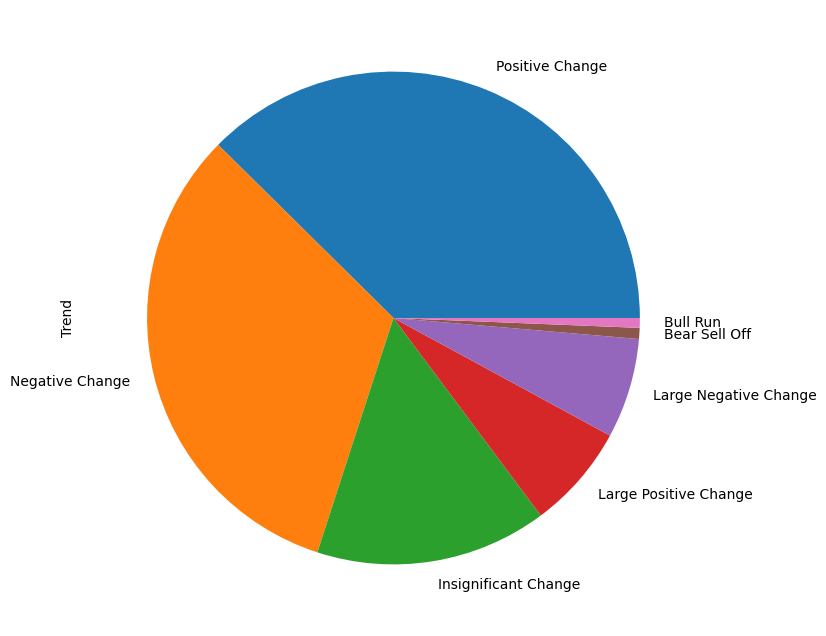

In [23]:
plt.figure(figsize = (8, 8))
trend_summary.plot(kind = 'pie', y = 'Trend');

<AxesSubplot:ylabel='Trend'>

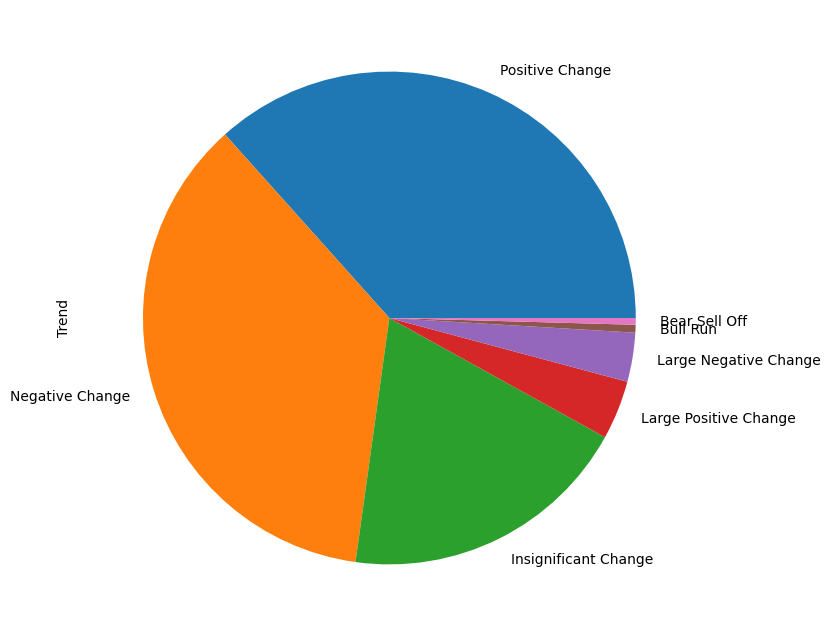

In [24]:
JPM_df["Trend"] = JPM_df["Daily Return"].apply(percentage_return_classifier)

trend_jpm = JPM_df["Trend"]
plt.figure(figsize = (8, 8))
JPM_df["Trend"].value_counts().plot(kind = 'pie', y = 'Trend')

In [25]:
cf.go_offline()

In [27]:
stock_df.set_index(['Date'], inplace = True)

,Open,High,Low,Close,Volume,Adj Close,Daily Return,Trend
Date,,,,,,,,
1/2/2018,58.599998,59.500000,58.525501,59.450500,53890000,59.450500,0.000000,Insignificant Change
1/3/2018,59.415001,60.274502,59.415001,60.209999,62176000,60.209999,1.277531,Positive Change
1/4/2018,60.250000,60.793499,60.233002,60.479500,60442000,60.479500,0.447601,Positive Change
1/5/2018,60.875500,61.457001,60.500000,61.457001,70894000,61.457001,1.616252,Positive Change
1/8/2018,61.799999,62.653999,61.601501,62.343498,85590000,62.343498,1.442468,Positive Change
...,...,...,...,...,...,...,...,...
12/12/2022,89.209999,90.580002,87.870003,90.550003,61999800,90.550003,1.638800,Positive Change
12/13/2022,95.230003,96.250000,90.519997,92.489998,100212000,92.489998,2.142457,Positive Change
12/14/2022,92.500000,93.459999,89.870003,91.580002,70298000,91.580002,-0.983886,Negative Change


In [28]:
figure = cf.QuantFig(stock_df, title = 'Amazon.com, Inc. (AMZN) Candlestick Chart', name = 'AMZN')
figure.add_sma(periods =[14, 21], column = 'Close', color = ['magenta', 'green'])
figure.iplot(theme = 'white', up_color = 'green', down_color = 'red')

In [29]:
JPM_df.set_index(["Date"], inplace = True)

,Open,High,Low,Close,Adj Close,Volume,Daily Return,Trend
Date,,,,,,,,
7/14/2017,90.809998,92.610001,90.580002,92.250000,79.338943,22235200,0.000000,Insignificant Change
7/17/2017,91.820000,91.989998,91.250000,91.389999,78.599312,14374200,-0.932243,Negative Change
7/18/2017,90.449997,91.580002,90.320000,91.070000,78.324104,14719400,-0.350140,Negative Change
7/19/2017,91.339996,91.620003,91.000000,91.199997,78.435898,11651200,0.142732,Insignificant Change
7/20/2017,91.150002,91.720001,90.900002,91.199997,78.435898,11561700,0.000000,Insignificant Change
...,...,...,...,...,...,...,...,...
12/12/2022,132.399994,134.649994,131.600006,134.210007,134.210007,8841600,1.551152,Positive Change
12/13/2022,136.889999,137.089996,133.080002,134.080002,134.080002,10025400,-0.096867,Insignificant Change
12/14/2022,133.779999,135.710007,132.759995,133.410004,133.410004,9966100,-0.499700,Negative Change


In [30]:
figure = cf.QuantFig(JPM_df, title = 'JPMC, Inc. (JPM) Candlestick Chart', name = 'JPMC')
figure.add_sma(periods =[30, 100], column = 'Close', color = ['magenta', 'green'])
figure.iplot(theme = 'white', up_color = 'green', down_color = 'red')

In [31]:
figure = cf.QuantFig(JPM_df, title = 'JPMC, Inc. (JPM) Candlestick Chart', name = 'JPM')
figure.add_bollinger_bands(periods = 20, boll_std = 2, color = ['magenta', 'green'])
figure.iplot(theme = 'white', up_color = 'green', down_color = 'red')

In [32]:
close_price_df = pd.read_csv('stock_prices.csv')
close_price_df

,Date,AMZN,CAT,DE,EXC,GOOGL,JNJ,JPM,META,PFE,PG
0,1/2/2014,19.898500,69.512543,75.620926,14.121004,27.855856,71.443314,45.640057,54.709999,20.879053,61.941517
1,1/3/2014,19.822001,69.473892,75.956062,13.835152,27.652653,72.086861,45.992889,54.560001,20.920183,61.872295
2,1/6/2014,19.681499,68.561180,75.327690,13.923512,27.960960,72.463608,46.259468,57.200001,20.940746,62.018425
3,1/7/2014,19.901501,68.785461,75.662811,13.996271,28.500000,74.001869,45.726311,57.919998,21.070980,62.618301
4,1/8/2014,20.096001,68.947906,74.850121,13.965082,28.559309,73.899841,46.157543,58.230000,21.214928,61.710812
...,...,...,...,...,...,...,...,...,...,...,...
2252,12/12/2022,90.550003,233.059998,437.049988,42.500000,93.309998,177.839996,134.210007,114.709999,52.160000,152.470001
2253,12/13/2022,92.489998,235.490005,437.190002,42.540001,95.629997,179.210007,134.080002,120.150002,53.070000,152.240005
2254,12/14/2022,91.580002,234.479996,438.440002,42.820000,95.070000,179.759995,133.410004,121.589996,54.480000,152.839996
2255,12/15/2022,88.449997,230.660004,429.790008,42.380001,90.860001,177.490005,130.100006,116.150002,53.610001,151.110001


In [33]:
daily_returns_df = close_price_df.iloc[:, 1:].pct_change() * 100
daily_returns_df.replace(np.nan, 0, inplace = True)
daily_returns_df

,AMZN,CAT,DE,EXC,GOOGL,JNJ,JPM,META,PFE,PG
0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,-0.384451,-0.055602,0.443179,-2.024307,-0.729481,0.900780,0.773077,-0.274169,0.196992,-0.111753
2,-0.708814,-1.313748,-0.827284,0.638662,1.114930,0.522629,0.579608,4.838708,0.098293,0.236179
3,1.117807,0.327126,0.444884,0.522567,1.927829,2.122805,-1.152537,1.258737,0.621916,0.967255
4,0.977313,0.236162,-1.074095,-0.222838,0.208102,-0.137872,0.943073,0.535223,0.683156,-1.449240
...,...,...,...,...,...,...,...,...,...,...
2252,1.638800,2.538609,0.515165,2.607441,0.517070,1.194942,1.551152,-1.026749,0.850732,1.027036
2253,2.142457,1.042653,0.032036,0.094120,2.486336,0.770361,-0.096867,4.742396,1.744632,-0.150847
2254,-0.983886,-0.428897,0.285917,0.658201,-0.585588,0.306896,-0.499700,1.198498,2.656868,0.394108
2255,-3.417782,-1.629133,-1.972903,-1.027554,-4.428315,-1.262789,-2.481072,-4.474048,-1.596914,-1.131900


In [34]:
daily_returns_df.insert(0, "Date", close_price_df['Date'])
daily_returns_df

,Date,AMZN,CAT,DE,EXC,GOOGL,JNJ,JPM,META,PFE,PG
0,1/2/2014,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,1/3/2014,-0.384451,-0.055602,0.443179,-2.024307,-0.729481,0.900780,0.773077,-0.274169,0.196992,-0.111753
2,1/6/2014,-0.708814,-1.313748,-0.827284,0.638662,1.114930,0.522629,0.579608,4.838708,0.098293,0.236179
3,1/7/2014,1.117807,0.327126,0.444884,0.522567,1.927829,2.122805,-1.152537,1.258737,0.621916,0.967255
4,1/8/2014,0.977313,0.236162,-1.074095,-0.222838,0.208102,-0.137872,0.943073,0.535223,0.683156,-1.449240
...,...,...,...,...,...,...,...,...,...,...,...
2252,12/12/2022,1.638800,2.538609,0.515165,2.607441,0.517070,1.194942,1.551152,-1.026749,0.850732,1.027036
2253,12/13/2022,2.142457,1.042653,0.032036,0.094120,2.486336,0.770361,-0.096867,4.742396,1.744632,-0.150847
2254,12/14/2022,-0.983886,-0.428897,0.285917,0.658201,-0.585588,0.306896,-0.499700,1.198498,2.656868,0.394108
2255,12/15/2022,-3.417782,-1.629133,-1.972903,-1.027554,-4.428315,-1.262789,-2.481072,-4.474048,-1.596914,-1.131900


In [35]:
plot_financial_data(close_price_df, 'Adjusted Closing Prices [$]')

In [36]:
plot_financial_data(daily_returns_df, 'Percentage Daily Returns [%]')

In [37]:
fig = px.histogram(daily_returns_df.drop(columns = ['Date']))
fig.update_layout({'plot_bgcolor': "white"})

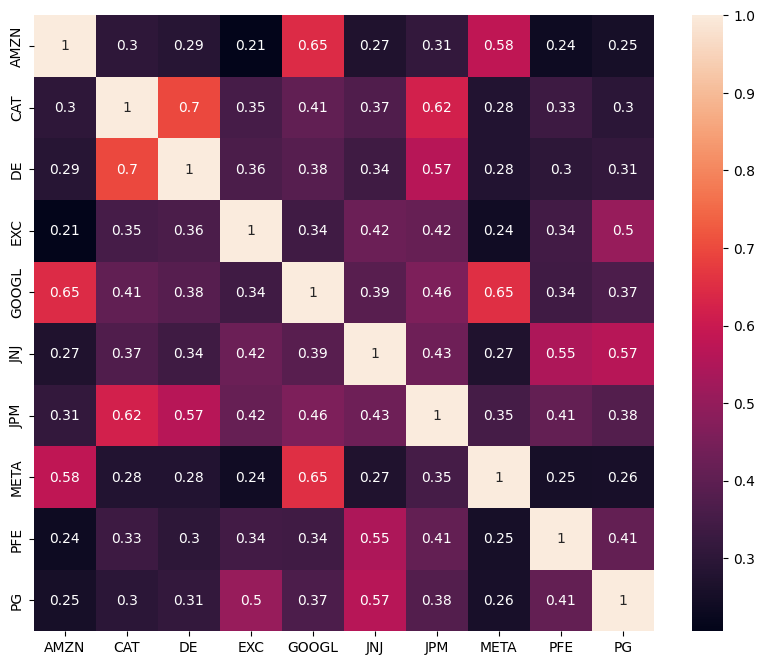

In [92]:
plt.figure(figsize = (10, 8))
sns.heatmap(daily_returns_df.drop(columns = ['Date']).corr(), annot = True);

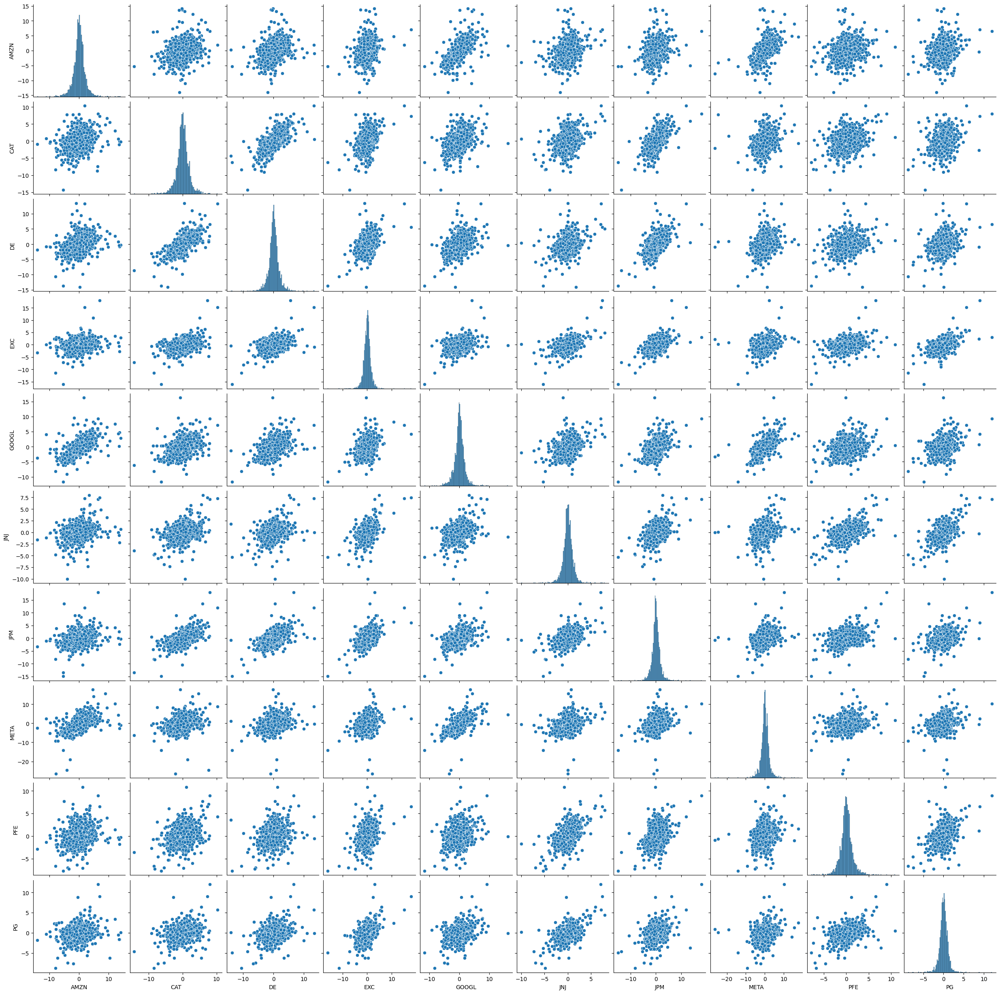

In [93]:
sns.pairplot(daily_returns_df);

In [94]:
def price_scaling(raw_prices_df):
    scaled_prices_df = raw_prices_df.copy()
    for i in raw_prices_df.columns[1:]:
          scaled_prices_df[i] = raw_prices_df[i]/raw_prices_df[i][0]
    return scaled_prices_df

In [41]:
price_scaling(close_price_df)

,Date,AMZN,CAT,DE,EXC,GOOGL,JNJ,JPM,META,PFE,PG
0,1/2/2014,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,1/3/2014,0.996155,0.999444,1.004432,0.979757,0.992705,1.009008,1.007731,0.997258,1.001970,0.998882
2,1/6/2014,0.989095,0.986314,0.996122,0.986014,1.003773,1.014281,1.013572,1.045513,1.002955,1.001242
3,1/7/2014,1.000151,0.989540,1.000554,0.991167,1.023124,1.035812,1.001890,1.058673,1.009192,1.010926
4,1/8/2014,1.009925,0.991877,0.989807,0.988958,1.025253,1.034384,1.011338,1.064339,1.016087,0.996275
...,...,...,...,...,...,...,...,...,...,...,...
2252,12/12/2022,4.550594,3.352776,5.779485,3.009701,3.349744,2.489246,2.940619,2.096692,2.498198,2.461515
2253,12/13/2022,4.648089,3.387734,5.781336,3.012534,3.433030,2.508422,2.937770,2.196125,2.541782,2.457802
2254,12/14/2022,4.602357,3.373204,5.797866,3.032362,3.412927,2.516121,2.923090,2.222446,2.609314,2.467489
2255,12/15/2022,4.445058,3.318250,5.683480,3.001203,3.261792,2.484347,2.850566,2.123012,2.567645,2.439559


In [97]:
plot_financial_data(price_scaling(close_price_df), "comparison")

In [99]:
import random

def generate_portfolio_weights(n):
    weights = []
    for i in range(n):
        weights.append(random.random())
        
    weights = weights/np.sum(weights)
    return weights

In [100]:
weights = generate_portfolio_weights(4)
print(weights)

[0.12428091 0.58418281 0.00990685 0.28162943]


In [104]:
weights_random = generate_portfolio_weights(10)
weights_random.sum()

0.9999999999999999

In [105]:
weights = [0.032266, 0.094461, 0.117917, 0.132624, 0.145942, 0.128299, 0.10009, 0.007403, 0.088581, 0.152417]
weights

[0.032266,
 0.094461,
 0.117917,
 0.132624,
 0.145942,
 0.128299,
 0.10009,
 0.007403,
 0.088581,
 0.152417]

In [106]:
close_price_df

,Date,AMZN,CAT,DE,EXC,GOOGL,JNJ,JPM,META,PFE,PG
0,1/2/2014,19.898500,69.512543,75.620926,14.121004,27.855856,71.443314,45.640057,54.709999,20.879053,61.941517
1,1/3/2014,19.822001,69.473892,75.956062,13.835152,27.652653,72.086861,45.992889,54.560001,20.920183,61.872295
2,1/6/2014,19.681499,68.561180,75.327690,13.923512,27.960960,72.463608,46.259468,57.200001,20.940746,62.018425
3,1/7/2014,19.901501,68.785461,75.662811,13.996271,28.500000,74.001869,45.726311,57.919998,21.070980,62.618301
4,1/8/2014,20.096001,68.947906,74.850121,13.965082,28.559309,73.899841,46.157543,58.230000,21.214928,61.710812
...,...,...,...,...,...,...,...,...,...,...,...
2252,12/12/2022,90.550003,233.059998,437.049988,42.500000,93.309998,177.839996,134.210007,114.709999,52.160000,152.470001
2253,12/13/2022,92.489998,235.490005,437.190002,42.540001,95.629997,179.210007,134.080002,120.150002,53.070000,152.240005
2254,12/14/2022,91.580002,234.479996,438.440002,42.820000,95.070000,179.759995,133.410004,121.589996,54.480000,152.839996
2255,12/15/2022,88.449997,230.660004,429.790008,42.380001,90.860001,177.490005,130.100006,116.150002,53.610001,151.110001


In [107]:
portfolio_df = close_price_df.copy()
scaled_df = price_scaling(portfolio_df)
scaled_df

,Date,AMZN,CAT,DE,EXC,GOOGL,JNJ,JPM,META,PFE,PG
0,1/2/2014,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,1/3/2014,0.996155,0.999444,1.004432,0.979757,0.992705,1.009008,1.007731,0.997258,1.001970,0.998882
2,1/6/2014,0.989095,0.986314,0.996122,0.986014,1.003773,1.014281,1.013572,1.045513,1.002955,1.001242
3,1/7/2014,1.000151,0.989540,1.000554,0.991167,1.023124,1.035812,1.001890,1.058673,1.009192,1.010926
4,1/8/2014,1.009925,0.991877,0.989807,0.988958,1.025253,1.034384,1.011338,1.064339,1.016087,0.996275
...,...,...,...,...,...,...,...,...,...,...,...
2252,12/12/2022,4.550594,3.352776,5.779485,3.009701,3.349744,2.489246,2.940619,2.096692,2.498198,2.461515
2253,12/13/2022,4.648089,3.387734,5.781336,3.012534,3.433030,2.508422,2.937770,2.196125,2.541782,2.457802
2254,12/14/2022,4.602357,3.373204,5.797866,3.032362,3.412927,2.516121,2.923090,2.222446,2.609314,2.467489
2255,12/15/2022,4.445058,3.318250,5.683480,3.001203,3.261792,2.484347,2.850566,2.123012,2.567645,2.439559


In [108]:
initial_investment = 1000000
for i, stock in enumerate(scaled_df.columns[1:]):
    portfolio_df[stock] = weights[i] * scaled_df[stock]  * initial_investment
portfolio_df.round(1)

,Date,AMZN,CAT,DE,EXC,GOOGL,JNJ,JPM,META,PFE,PG
0,1/2/2014,32266.0,94461.0,117917.0,132624.0,145942.0,128299.0,100090.0,7403.0,88581.0,152417.0
1,1/3/2014,32142.0,94408.5,118439.6,129939.3,144877.4,129454.7,100863.8,7382.7,88755.5,152246.7
2,1/6/2014,31914.1,93168.2,117459.8,130769.2,146492.7,130131.3,101448.4,7739.9,88842.7,152606.2
3,1/7/2014,32270.9,93473.0,117982.3,131452.5,149316.8,132893.7,100279.2,7837.4,89395.3,154082.3
4,1/8/2014,32586.3,93693.7,116715.1,131159.6,149627.5,132710.5,101224.9,7879.3,90006.0,151849.3
...,...,...,...,...,...,...,...,...,...,...,...
2252,12/12/2022,146829.5,316706.6,681499.5,399158.6,488868.4,319367.8,294326.5,15521.8,221292.8,375176.8
2253,12/13/2022,149975.2,320008.7,681717.8,399534.3,501023.3,321828.1,294041.4,16257.9,225153.6,374610.9
2254,12/14/2022,148499.6,318636.2,683667.0,402164.0,498089.4,322815.8,292572.1,16452.8,231135.6,376087.2
2255,12/15/2022,143424.3,313445.2,670178.9,398031.6,476032.4,318739.3,285313.2,15716.7,227444.6,371830.3


In [109]:
def asset_allocation(df, weights, initial_investment):
    portfolio_df = df.copy()

    scaled_df = price_scaling(df)
  
    for i, stock in enumerate(scaled_df.columns[1:]):
        portfolio_df[stock] = scaled_df[stock] * weights[i] * initial_investment

    portfolio_df['Portfolio Value [$]'] = portfolio_df[portfolio_df != 'Date'].sum(axis = 1, numeric_only = True)
    portfolio_df['Portfolio Daily Return [%]'] = portfolio_df['Portfolio Value [$]'].pct_change(1) * 100 
    portfolio_df.replace(np.nan, 0, inplace = True)
    
    return portfolio_df

In [110]:

n = len(close_price_df.columns)-1

print('Number of stocks under consideration = {}'.format(n))
weights = generate_portfolio_weights(n).round(6)
print('Portfolio weights = {}'.format(weights))

portfolio_df = asset_allocation(close_price_df, weights, 1000000)
portfolio_df.round(2)

Number of stocks under consideration = 10
Portfolio weights = [0.090931 0.097213 0.019584 0.016469 0.133789 0.121983 0.166378 0.159283
 0.082342 0.112027]


,Date,AMZN,CAT,DE,EXC,GOOGL,JNJ,JPM,META,PFE,PG,Portfolio Value [$],Portfolio Daily Return [%]
0,1/2/2014,90931.00,97213.00,19584.00,16469.00,133789.00,121983.00,166378.00,159283.00,82342.00,112027.00,999999.00,0.00
1,1/3/2014,90581.42,97158.95,19670.79,16135.62,132813.03,123081.80,167664.23,158846.30,82504.21,111901.81,1000358.14,0.04
2,1/6/2014,89939.36,95882.52,19508.06,16238.67,134293.81,123725.06,168636.03,166532.40,82585.30,112166.10,1009507.31,0.91
3,1/7/2014,90944.71,96196.18,19594.85,16323.53,136882.76,126351.50,166692.43,168628.61,83098.91,113251.03,1017964.51,0.84
4,1/8/2014,91833.52,96423.36,19384.38,16287.15,137167.62,126177.30,168264.47,169531.15,83666.61,111609.75,1020345.30,0.23
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2252,12/12/2022,413790.09,325933.43,113185.43,49566.77,448158.95,303645.72,489254.27,333967.34,205706.58,275756.19,2958964.77,1.06
2253,12/13/2022,422655.37,329331.79,113221.69,49613.42,459301.69,305984.89,488780.34,349805.39,209295.41,275340.22,3003330.20,1.50
2254,12/14/2022,418496.92,327919.29,113545.41,49939.97,456612.08,306923.94,486337.91,353997.80,214856.11,276425.36,3005054.79,0.06
2255,12/15/2022,404193.61,322577.05,111305.27,49426.81,436391.85,303048.14,474271.52,338159.77,211425.04,273296.50,2924095.57,-2.69


In [50]:
plot_financial_data(portfolio_df[['Date', 'Portfolio Daily Return [%]']], 'Portfolio Percentage Daily Return [%]')

plot_financial_data(portfolio_df.drop(['Portfolio Value [$]', 'Portfolio Daily Return [%]'], axis = 1), 'Portfolio positions [$]')

plot_financial_data(portfolio_df[['Date', 'Portfolio Value [$]']], 'Total Portfolio Value [$]')

In [127]:
weights = generate_portfolio_weights(10)
por_df = asset_allocation(close_price_df,weights, 1000000)
plot_financial_data(por_df[["Date",'Portfolio Value [$]']] ,"Total Value")

In [134]:
def simulation_engine(weights, initial_investment):
    portfolio_df = asset_allocation(close_price_df, weights, initial_investment)
  
    return_on_investment = ((portfolio_df['Portfolio Value [$]'][-1:] - 
                             portfolio_df['Portfolio Value [$]'][0])/ 
                             portfolio_df['Portfolio Value [$]'][0]) * 100
  
    portfolio_daily_return_df = portfolio_df.drop(columns = ['Date', 'Portfolio Value [$]', 'Portfolio Daily Return [%]'])
    portfolio_daily_return_df = portfolio_daily_return_df.pct_change(1) 
 
    expected_portfolio_return = np.sum(weights * portfolio_daily_return_df.mean() ) * 252

    covariance = portfolio_daily_return_df.cov() * 252 
    expected_volatility = np.sqrt(np.dot(weights.T, np.dot(covariance, weights)))

    rf = 0.01

    sharpe_ratio = (expected_portfolio_return - rf)/expected_volatility 
    return expected_portfolio_return, expected_volatility, sharpe_ratio, portfolio_df['Portfolio Value [$]'][-1:].values[0], return_on_investment.values[0]
  

In [129]:

initial_investment = 1000000
portfolio_metrics = simulation_engine(weights, initial_investment)

In [130]:
print('Expected Portfolio Annual Return = {:.2f}%'.format(portfolio_metrics[0] * 100))
print('Portfolio Standard Deviation (Volatility) = {:.2f}%'.format(portfolio_metrics[1] * 100))
print('Sharpe Ratio = {:.2f}'.format(portfolio_metrics[2]))
print('Portfolio Final Value = ${:.2f}'.format(portfolio_metrics[3]))
print('Return on Investment = {:.2f}%'.format(portfolio_metrics[4]))


Expected Portfolio Annual Return = 16.63%
Portfolio Standard Deviation (Volatility) = 21.08%
Sharpe Ratio = 0.65
Portfolio Final Value = $3057646.84
Return on Investment = 205.76%


In [135]:
weights = np.full(10, 0.1)
met=simulation_engine(weights,1000000)
met

(0.16299368412294776,
 0.18016347294330073,
 0.8491936885069729,
 3203874.76368856,
 220.38747636885603)

# MONTE CARLO SIMULATIONS 

In [138]:
sim_runs = 10000
initial_investment = 1000000

weights_runs = np.zeros((sim_runs, n))

sharpe_ratio_runs = np.zeros(sim_runs)

expected_portfolio_returns_runs = np.zeros(sim_runs)

volatility_runs = np.zeros(sim_runs)

return_on_investment_runs = np.zeros(sim_runs)

final_value_runs = np.zeros(sim_runs)

for i in range(sim_runs):
    
    weights = generate_portfolio_weights(n)
    
    weights_runs[i,:] = weights
    
    expected_portfolio_returns_runs[i], volatility_runs[i], sharpe_ratio_runs[i], final_value_runs[i], return_on_investment_runs[i] = simulation_engine(weights, initial_investment)
    print("Simulation Run = {}".format(i))   
    print("Weights = {}, Final Value = ${:.2f}, Sharpe Ratio = {:.2f}".format(weights_runs[i].round(3), final_value_runs[i], sharpe_ratio_runs[i]))   
    print('\n')


Simulation Run = 0
Weights = [0.114 0.15  0.091 0.151 0.124 0.011 0.011 0.051 0.117 0.178], Final Value = $3270809.62, Sharpe Ratio = 0.87


Simulation Run = 1
Weights = [0.141 0.097 0.167 0.16  0.132 0.072 0.135 0.049 0.018 0.028], Final Value = $3582530.14, Sharpe Ratio = 0.87


Simulation Run = 2
Weights = [0.143 0.111 0.008 0.117 0.11  0.113 0.123 0.059 0.122 0.094], Final Value = $3035132.92, Sharpe Ratio = 0.83


Simulation Run = 3
Weights = [0.121 0.149 0.029 0.094 0.168 0.162 0.111 0.127 0.009 0.031], Final Value = $3105711.92, Sharpe Ratio = 0.79


Simulation Run = 4
Weights = [0.12  0.102 0.16  0.126 0.071 0.15  0.126 0.018 0.061 0.067], Final Value = $3462807.85, Sharpe Ratio = 0.89


Simulation Run = 5
Weights = [0.006 0.158 0.085 0.155 0.087 0.094 0.034 0.173 0.129 0.078], Final Value = $2997095.54, Sharpe Ratio = 0.80


Simulation Run = 6
Weights = [0.124 0.009 0.055 0.176 0.13  0.004 0.195 0.114 0.012 0.182], Final Value = $3113536.20, Sharpe Ratio = 0.80


Simulation Ru

In [150]:
sim_runs = 10
initial_investment = 1000000

sharpe = np.zeros(sim_runs)
weights_run = np.zeros((sim_runs, n))

for i in range(sim_runs):
    weights = generate_portfolio_weights(n)
    weights_run[i,:] = weights
    expected_portfolio_returns_runs[i], volatility_runs[i], sharpe[i], final_value_runs[i], return_on_investment_runs[i] = simulation_engine(weights, initial_investment)
    
min(sharpe)

0.7657174601478536

# PORTFOLIO OPTIMIZATION 

In [151]:
sharpe_ratio_runs

array([0.82450666, 0.83284233, 0.79251783, ..., 0.78963991, 0.85580361,
       0.89112462])

In [152]:
sharpe_ratio_runs.argmax()

7857

In [153]:
sharpe_ratio_runs.max()

0.9329170917820195

In [58]:
weights_runs

array([[0.04566171, 0.11952015, 0.08824305, ..., 0.05840391, 0.12426474,
        0.03763488],
       [0.0298156 , 0.08031552, 0.10428357, ..., 0.10313718, 0.11282557,
        0.0370641 ],
       [0.15049634, 0.09004763, 0.16379037, ..., 0.07980725, 0.15068976,
        0.0206995 ],
       ...,
       [0.03173304, 0.04465608, 0.15956415, ..., 0.09450366, 0.11968199,
        0.04443429],
       [0.16560924, 0.13641579, 0.15936299, ..., 0.00353187, 0.15665976,
        0.08727965],
       [0.14723086, 0.02433737, 0.12682724, ..., 0.17012945, 0.02742861,
        0.02474229]])

In [59]:
weights_runs[sharpe_ratio_runs.argmax(), :]

array([0.18642704, 0.03691534, 0.21409747, 0.17613595, 0.07867543,
       0.11521777, 0.00259308, 0.00694896, 0.1385006 , 0.04448835])

In [60]:
optimal_portfolio_return, optimal_volatility, optimal_sharpe_ratio, highest_final_value, optimal_return_on_investment = simulation_engine(weights_runs[sharpe_ratio_runs.argmax(), :], initial_investment)

In [61]:
print('Best Portfolio Metrics Based on {} Monte Carlo Simulation Runs:'.format(sim_runs))
print('  - Portfolio Expected Annual Return = {:.02f}%'.format(optimal_portfolio_return * 100))
print('  - Portfolio Standard Deviation (Volatility) = {:.02f}%'.format(optimal_volatility * 100))
print('  - Sharpe Ratio = {:.02f}'.format(optimal_sharpe_ratio))
print('  - Final Value = ${:.02f}'.format(highest_final_value))
print('  - Return on Investment = {:.02f}%'.format(optimal_return_on_investment))

Best Portfolio Metrics Based on 10000 Monte Carlo Simulation Runs:
  - Portfolio Expected Annual Return = 17.64%
  - Portfolio Standard Deviation (Volatility) = 17.89%
  - Sharpe Ratio = 0.82
  - Final Value = $3700006.05
  - Return on Investment = 270.00%


In [62]:
sim_out_df = pd.DataFrame({'Volatility': volatility_runs.tolist(), 'Portfolio_Return': expected_portfolio_returns_runs.tolist(), 'Sharpe_Ratio': sharpe_ratio_runs.tolist() })
sim_out_df

,Volatility,Portfolio_Return,Sharpe_Ratio
0,0.180201,0.158879,0.715196
1,0.187047,0.159543,0.692567
2,0.181635,0.170594,0.774047
3,0.188062,0.160268,0.692688
4,0.183600,0.161832,0.718038
...,...,...,...
9995,0.180546,0.160455,0.722557
9996,0.179343,0.152710,0.684222
9997,0.177378,0.161922,0.743734
9998,0.185250,0.174125,0.778000


In [63]:
import plotly.graph_objects as go
fig = px.scatter(sim_out_df, x = 'Volatility', y = 'Portfolio_Return', color = 'Sharpe_Ratio', size = 'Sharpe_Ratio', hover_data = ['Sharpe_Ratio'] )
fig.update_layout({'plot_bgcolor': "white"})
fig.show()

In [64]:
fig = px.scatter(sim_out_df, x = 'Volatility', y = 'Portfolio_Return', color = 'Sharpe_Ratio', size = 'Sharpe_Ratio', hover_data = ['Sharpe_Ratio'] )
fig.add_trace(go.Scatter(x = [optimal_volatility], y = [optimal_portfolio_return], mode = 'markers', name = 'Optimal Point', marker = dict(size=[40], color = 'red')))
fig.update_layout(coloraxis_colorbar = dict(y = 0.7, dtick = 5))
fig.update_layout({'plot_bgcolor': "white"})
fig.show()

In [154]:
fig = px.line(sim_out_df, y = 'Volatility')
fig.show()

fig = px.line(sim_out_df, y = 'Portfolio_Return')
fig.update_traces(line_color = 'red')
fig.show()

fig = px.line(sim_out_df, y = 'Sharpe_Ratio')
fig.update_traces(line_color = 'purple')
fig.show()